## Importing Data

In [1]:
import anndata
import scvelo as scv
import pandas as pd
import numpy as np
import matplotlib as plt

In [2]:
#import data
e3 = anndata.read_h5ad("/rugpfs/fs0/tavz_lab/scratch/amillet/KB_notebook/output_1_h5ad/counts_unfiltered/adata.h5ad")
e4 = anndata.read_h5ad("/rugpfs/fs0/tavz_lab/scratch/amillet/KB_notebook/output_2_h5ad/counts_unfiltered/adata.h5ad")
young = anndata.read_h5ad("/rugpfs/fs0/tavz_lab/scratch/amillet/12_07_2021_Alon/kb_count/counts_unfiltered/adata.h5ad")

In [3]:
#import metadata
e3_barcodes = pd.read_csv("/rugpfs/fs0/tavz_lab/scratch/amillet/12_07_2021_Alon/scVelo_metadata/mglia_only/corrected_references/E3_2yr_cells.csv")
e3_umap = pd.read_csv("/rugpfs/fs0/tavz_lab/scratch/amillet/12_07_2021_Alon/scVelo_metadata/mglia_only/corrected_references/E3_2yr_embeddings.csv")
e3_clust = pd.read_csv("/rugpfs/fs0/tavz_lab/scratch/amillet/12_07_2021_Alon/scVelo_metadata/mglia_only/corrected_references/E3_2yr_clusters.csv")

e4_barcodes = pd.read_csv("/rugpfs/fs0/tavz_lab/scratch/amillet/12_07_2021_Alon/scVelo_metadata/mglia_only/corrected_references/E4_2yr_cells.csv")
e4_umap = pd.read_csv("/rugpfs/fs0/tavz_lab/scratch/amillet/12_07_2021_Alon/scVelo_metadata/mglia_only/corrected_references/E4_2yr_embeddings.csv")
e4_clust = pd.read_csv("/rugpfs/fs0/tavz_lab/scratch/amillet/12_07_2021_Alon/scVelo_metadata/mglia_only/corrected_references/E4_2yr_clusters.csv")

young_barcodes = pd.read_csv("/rugpfs/fs0/tavz_lab/scratch/amillet/12_07_2021_Alon/scVelo_metadata/mglia_only/corrected_references/20wk_cells.csv")
young_umap = pd.read_csv("/rugpfs/fs0/tavz_lab/scratch/amillet/12_07_2021_Alon/scVelo_metadata/mglia_only/corrected_references/20wk_embeddings.csv")
young_clust = pd.read_csv("/rugpfs/fs0/tavz_lab/scratch/amillet/12_07_2021_Alon/scVelo_metadata/mglia_only/corrected_references/20wk_clusters.csv")

## Pre-processing and adding in our metadata from Seurat

In [4]:
#filtering to remove all empty droplets
e3 = e3[e3_barcodes["."]].copy()
e4 = e4[e4_barcodes["."]].copy()
young = young[young_barcodes["."]].copy()

In [5]:
#adding in UMAP metadata
e3_umap_coord = e3_umap.iloc[:,1:]
e3.obsm['X_umap'] = e3_umap_coord.values
e4_umap_coord = e4_umap.iloc[:,1:]
e4.obsm['X_umap'] = e4_umap_coord.values
young_umap_coord = young_umap.iloc[:,1:]
young.obsm['X_umap'] = young_umap_coord.values

In [6]:
#merging e3 and e4 together after filtering
adata = e3.concatenate(e4,young)

In [7]:
#running leiden clustering and overwriting with our clusters from seurat
scv.pp.neighbors(adata)
scv.tl.louvain(adata)

computing neighbors
    finished (0:00:27) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)


In [8]:
#adding in cluster metadata
e3_label = e3_clust.iloc[:,1:]
e4_label = e4_clust.iloc[:,1:]
young_label = young_clust.iloc[:,1:]
labels = pd.concat([e3_label,e4_label,young_label])
adata.obs['louvain'] = labels.values

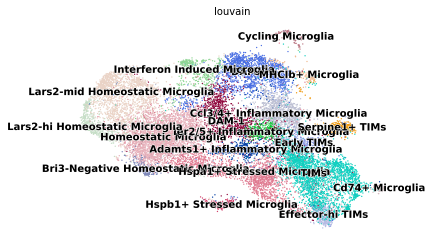

In [9]:
#check to make sure labels and umap look ok!
scv.pl.umap(adata, color="louvain")

## Computing velocity with scVelo

In [10]:
#start running scv...
scv.pp.filter_and_normalize(adata)
scv.pp.moments(adata)

Normalized count data: X, spliced, unspliced.
Logarithmized X.
computing moments based on connectivities
    finished (0:00:22) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [11]:
#running scv in dynamics mode (not stochastic!)
scv.tl.recover_dynamics(adata, n_jobs = 24)
scv.tl.velocity(adata, mode="dynamical")
scv.tl.velocity_graph(adata)

recovering dynamics (using 24/24 cores)



    finished (0:11:23) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:47) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/24 cores)



    finished (0:01:20) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [12]:
#get latent time
scv.tl.latent_time(adata)

computing terminal states
    identified 3 regions of root cells and 1 region of end points .
    finished (0:00:07) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:47) --> added 
    'latent_time', shared time (adata.obs)


## Correct for differential kinetics in top genes

In [13]:
top_genes = adata.var['fit_likelihood'].sort_values(ascending=False).index[:100]
scv.tl.differential_kinetic_test(adata, var_names=top_genes, groupby='louvain')

testing for differential kinetics
    finished (0:01:43) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pvals_kinetics', p-values of differential kinetics (adata.var)


In [16]:
scv.tl.velocity(adata, mode = "dynamical", diff_kinetics=True)
scv.tl.velocity_graph(adata)

computing velocities
    finished (0:02:59) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/24 cores)



    finished (0:01:18) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


## Save or load the data:

In [4]:
#saving:
#adata.write("/rugpfs/fs0/tavz_lab/scratch/amillet/12_07_2021_Alon/scVelo_metadata/corr_ref_unified_adapoe_mglia_only.h5ad", compression = "gzip")
#reading back:
adata = scv.read("/rugpfs/fs0/tavz_lab/scratch/amillet/12_07_2021_Alon/scVelo_metadata/corr_ref_unified_adapoe_mglia_only.h5ad")

## Now let's plot!

In [2]:
scv.settings.presenter_view = True  # set max width size for presenter view
scv.settings.set_figure_params('scvelo')  # for beautified visualization

In [9]:
adata.obsm["velocity_umap"] = -adata.obsm["velocity_umap"]

In [11]:
scv.pl.velocity_embedding_stream(adata, basis = "umap", dpi = 600, figsize=(25,20), color = "louvain", save = "stream.png",
                                legend_fontsize = 12, legend_fontoutline = 2,
                                title = "",
                                fontsize = 10, linewidth = 4)

saving figure to file ./figures/scvelo_stream.png
